## Chapter 03: Linear regression model
### A. Pyro modelling
### 1. Introduction
Operational data of a plant for the oxidation of ammonia to nitric acid.

“Obtained from 21 days of operation of a plant for the oxidation of ammonia (NH3) to nitric acid (HNO3). The nitric oxides produced are absorbed in a countercurrent absorption tower”. (Brownlee, cited by Dodge, slightly reformatted by MM.)

Air Flow represents the rate of operation of the plant. Water Temp is the temperature of cooling water circulated through coils in the absorption tower. Acid Conc. is the concentration of the acid circulating, minus 50, times 10: that is, 89 corresponds to 58.9 per cent acid. stack.loss (the dependent variable) is 10 times the percentage of the ingoing ammonia to the plant that escapes from the absorption column unabsorbed; that is, an (inverse) measure of the over-all efficiency of the plant.

In [1]:
import os
from functools import partial
import torch
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly
import pyro
from scipy import stats
import pyro.distributions as dist
from torch import nn
from pyro.nn import PyroModule
from pyro.infer import MCMC, NUTS

import random
import numpy as np
import time
import random
import pandas as pd
from collections import defaultdict
import plotly.express as px
import re
import itertools
from difflib import SequenceMatcher

from chapter03 import base

pyro.set_rng_seed(1)

plt.style.use('default')

%matplotlib inline
%load_ext autoreload

#### Data
<br>
stacks data

**Following standardises Data**

In [2]:
# X1, X2, X3, Y = load_data()
X1, X2, X3, Y = base.load_data()

print("X1: %s\nX2: %s\nX3: %s\nY: %s"%(X1.shape, X2.shape, X3.shape, Y.shape))

X1: torch.Size([21])
X2: torch.Size([21])
X3: torch.Size([21])
Y: torch.Size([21])


### 2. Model Specification
________
**Stack Model definition**

**beta0 ~ normal(0, 316);**

**beta ~ normal(0, 316);**

**sigmasq ~ inv_gamma(.001, .001);**

In [3]:
StackModel= base.StackModel
StackModel

<function chapter03.base.StackModel(X1, X2, X3, Y, beta_prior=None, sigma_prior=None, **kwargs)>

In [4]:
num_samples = 1100 

beta0_prior, beta1_prior, beta2_prior, beta3_prior, sigma_prior= base.init_priors({"default":dist.Normal(0., 316.),
                                                                             "sigma":dist.InverseGamma(0.001, 0.001)})# Pass priors for model A
prior_samples_dict = base.get_prior_samples(num_samples=num_samples, beta0= beta0_prior, beta1= beta1_prior, 
                                    beta2= beta2_prior, beta3=beta3_prior, sigma=sigma_prior)


### 3. Prior predictive checking

Prior predictive checking (PiPC)

In [5]:

original_plus_simulated_data_prior, original_plus_simulated_prior_df = base.simulate_observations_given_prior_posterior_pairs(Y, 
                                                                                                                    model_normal_a= prior_samples_dict)



___________

For model 'model_normal_a' prior
total samples count: 1100  sample example:  [(208.98727416992188, -602.7005004882812, -134.3204803466797, -143.1123809814453, 8.50705957708709e+34), (84.3480224609375, 779.6959838867188, -561.7835083007812, 72.6297836303711, 8.50705957708709e+34)]
Total execution time: 0.03732800483703613


_______________________________________________________
______________________________________________________________________
'prior_day_X' corresponds to observations simulated from prior of the given model, , 'day_X *' corresponds to the original observations for N-th day.


### 4. Posterior Estimation

In the Bayesian setting, inference is drawn from the posterior.  Here, posterior implies the updated beliefs about the random variables, in the wake of given evidences (data). Formally,
<br>
<br>
$Posterior = \frac {Likelihood x Prior}{Probability \ of Evidence}$
<br>
<br>
In our case, $\alpha,\beta$ are the parameters (actually random variables) & $y$ is the evidence;  According to the Bayes rule, Posterior $P(\alpha,\beta | y)$ is given as:
<br>
<br>
$P\ (\alpha,\beta | y) = \frac {P(y | \alpha,\beta) \pi(\alpha,\beta)}{P(y)}$
<br>
<br>

Now our interest is in estimating the posterior summaries of the parameters $\alpha, \beta$. For example, we can look at the posterior of mean of $\alpha$, denoted as $E(\alpha)$. However, in order to the get the posterior quanitities, either we need to compute the integrals or approximate the integrals via _Markov Chain Monte Carlo_. 

The latter can be easily accomplished in Pyro by using the [NUTS](https://arxiv.org/pdf/1111.4246.pdf) sampler -- NUTS is a specific sampler designed to draw samples efficiently from the posterior using _Hamiltonian Monte Carlo dynamics_.

The following code snippet takes a [pyro](http://pyro.ai/examples/intro_part_i.html) model object with -- posterior specification, input data, some configuration parameters such as a number of chains and number of samples per chain. It then launches a NUTS sampler and produces MCMC samples in a python dictionary format.

In [6]:

hmc_sample_chains_a, hmc_chain_diagnostics_a = base.get_hmc_n_chains(StackModel, X1, X2, X3, Y, num_chains=4, 
                                                                     sample_count = 900, beta_prior= dist.Normal(0., 316.), 
                                                                     sigma_prior= dist.InverseGamma(0.001, 0.001))



Sample: 100%|██████████████████████████████████████| 11000/11000 [53:25,  3.43it/s, step size=7.36e-02, acc. prob=0.940]             
/Users/tachyon/Desktop/pyro-venv/pyro-venv/miniforge_x86_64/envs/pytorch_x86/lib/python3.8/site-packages/pyro/infer/mcmc/util.py:438: UserWarning:

Traceback (most recent call last):
  File "/Users/tachyon/Desktop/pyro-venv/pyro-venv/miniforge_x86_64/envs/pytorch_x86/lib/python3.8/site-packages/pyro/infer/mcmc/util.py", line 436, in wrapped
    val = fn(sample, *args, **kwargs)
  File "/Users/tachyon/Desktop/pyro-venv/pyro-venv/miniforge_x86_64/envs/pytorch_x86/lib/python3.8/site-packages/pyro/ops/stats.py", line 181, in effective_sample_size
    gamma_k_c = autocovariance(input, dim=0)  # N x C x sample_shape
  File "/Users/tachyon/Desktop/pyro-venv/pyro-venv/miniforge_x86_64/envs/pytorch_x86/lib/python3.8/site-packages/pyro/ops/stats.py", line 132, in autocovariance
    return autocorrelation(input, dim) * input.var(dim, unbiased=False, keepdim=True)
 


Total time:  4433.226552963257


### 5. MCMC Diagnostics
Diagnosing the computational approximation

Just like any numerical technique, no matter how good the theory is or how robust the implementation is, it is always a good idea to check if indeed the samples drawn are reasonable. In the ideal situation, we expect the samples drawn by the sampler to be independant, and identically distributed (i.i.d) as the posterior distribution. In practice, this is far from true as MCMC itself is an approximate technique and a lot can go wrong. In particular, chains may not have converged or samples are very correlated. We can divide diagnosis into three sections.

- __Burn-in__: What is the effect of initialization? By visually inspecting the chains, we can notice the transient behaviour. We can drop the first "n" number of samples from the chain.

- __Thinning__: What is the intra chain correlation? We can use ACF (Auto-correlation function) to inspect it. A rule of thumb is, thin the chains such that, the ACF drops to $1/10^{th}$. Here, ACF drops to less than 0.1 at lag 5, then we retain only every $5^{th}$ sample in the chain.

- __Mixing__: Visually, all the chains, when plotted, should be indistinguishable from each other. At a very broad level, the means of the chains and variances shall be close. These are the two central moments we can track easily and turn them into Gelman-Rubin statistic. Other summmary statistics can be tracked, of course. 

We can use both visual and more formal statistical techniques to inspect the quality of the fit (not the model fit to the data, but how well the approximation is, having accepted the model class for the data at hand) by  treating chains as time-series data, and that we can run several chains in parallel. We precisely do that next. 

Following snippet allows plotting **Parameter vs. Chain matrix** and optionally saving the dataframe.

#### Model-A Summaries

**Parameter vs. Chain matrix**

In [7]:
# Unpruned sample chains for model A with HalfNormal prior

beta_chain_matrix_df_A = pd.DataFrame(hmc_sample_chains_a)

base.save_parameter_chain_dataframe(beta_chain_matrix_df_A, "data/stack_regression_hmc_sample_chains.csv")


Button(button_style='info', description='Save', icon='save', style=ButtonStyle(), tooltip='save')

Saved at 'data/stack_regression_hmc_sample_chains.csv'


##### A.1 Visual summary

###### A.1.1 Intermixing chains 
Sample chains mixing for `beta` & `sigma` parameters.

Following plots chains of samples for `beta` & `sigma` parameters for `model_a`

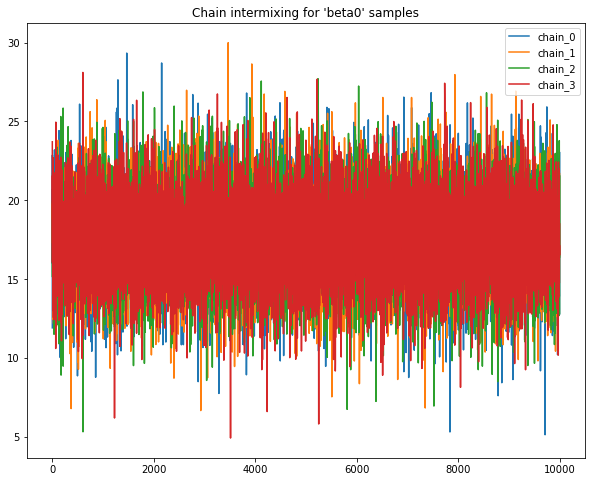

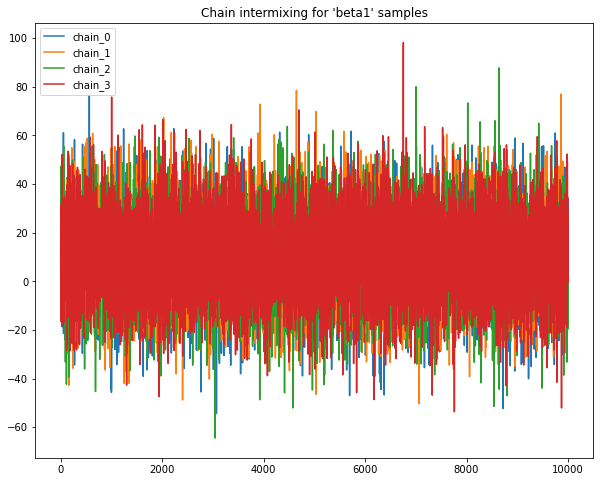

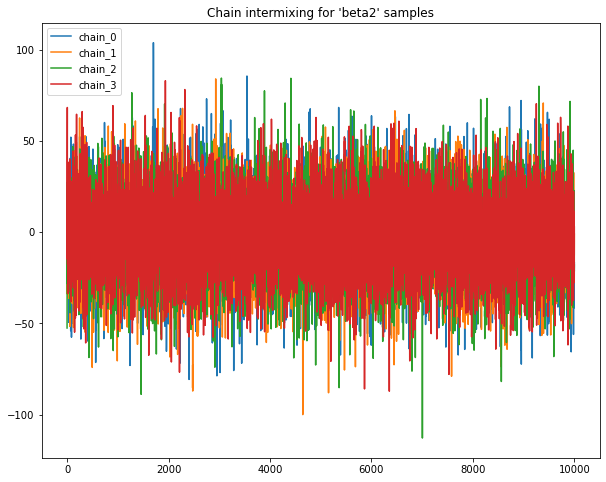

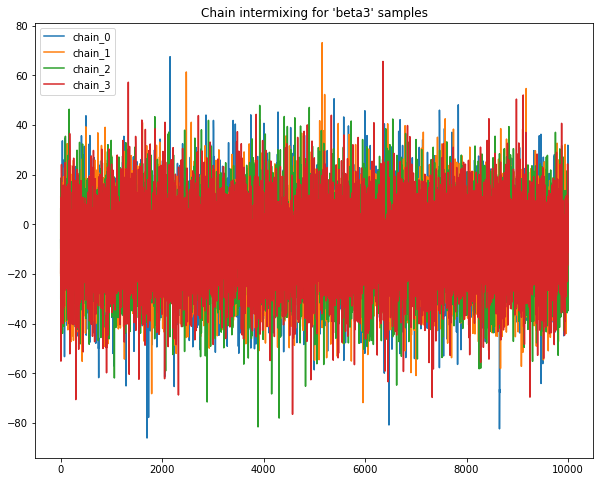

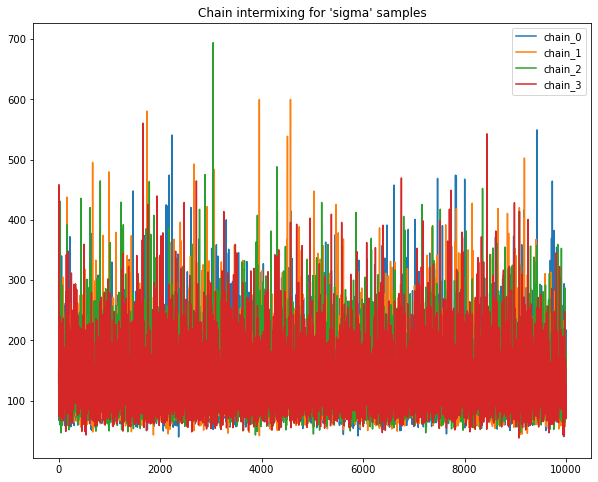

____
For 'model_a' chain_0
chain_0 Sample count:  10000
beta0 Q(0.5) :tensor(17.5991) | beta1 Q(0.5) :tensor(9.8707) | beta2 Q(0.5) :tensor(-1.8238) | beta3 Q(0.5) :tensor(-8.0039) | sigma Q(0.5) :tensor(124.4989)
____
For 'model_a' chain_1
chain_1 Sample count:  10000
beta0 Q(0.5) :tensor(17.5549) | beta1 Q(0.5) :tensor(9.5984) | beta2 Q(0.5) :tensor(-1.6869) | beta3 Q(0.5) :tensor(-7.9215) | sigma Q(0.5) :tensor(122.8252)
____
For 'model_a' chain_2
chain_2 Sample count:  10000
beta0 Q(0.5) :tensor(17.6016) | beta1 Q(0.5) :tensor(9.9737) | beta2 Q(0.5) :tensor(-2.1218) | beta3 Q(0.5) :tensor(-8.0496) | sigma Q(0.5) :tensor(124.3839)
____
For 'model_a' chain_3
chain_3 Sample count:  10000
beta0 Q(0.5) :tensor(17.5498) | beta1 Q(0.5) :tensor(10.1570) | beta2 Q(0.5) :tensor(-1.6141) | beta3 Q(0.5) :tensor(-8.6680) | sigma Q(0.5) :tensor(123.7581)


In [8]:

base.plot_chains(beta_chain_matrix_df_A)

for chain, samples in hmc_sample_chains_a.items():
    print("____\nFor 'model_a' %s"%chain)
    print_median = lambda param : "%s Q(0.5) :%s"%(param, torch.quantile(samples[param], 0.5))
    samples= dict(map(lambda param: (param, torch.tensor(samples.get(param))), samples.keys()))# np array to tensors
    print(chain, "Sample count: ", len(samples["sigma"]))
    print(" | ".join(map(print_median, samples.keys())))


##### A.2 Quantitative summary

###### A.2.1 ACF plots
Auto-correlation plots for sample chains of parameters

In [9]:
#Optionally input parameters & chains of choice.
parameters=['beta0', 'beta1', 'beta2', 'beta3', 'sigma']
chains= ['chain_0', 'chain_1']

base.plot_autocorrelation(beta_chain_matrix_df_A, parameters= parameters, chains= chains)


Autocorrelation for 'beta0'


Autocorrelation for 'beta1'


Autocorrelation for 'beta2'


Autocorrelation for 'beta3'


Autocorrelation for 'sigma'



- For `beta0`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta1`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta2`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

- For `beta3`, `thinin factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3

- For `sigma`, `thining factor` for `chain_0` is 3, `chain_1` is 3, `chain_2` is 3, `chain_3` is 3.

Pruning chains from model

In [10]:
thining_dict_a = {"chain_0": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3},
                  "chain_1": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}, 
                 "chain_2": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}, 
                 "chain_3": {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3}}

pruned_hmc_sample_chains_a = base.prune_hmc_samples(hmc_sample_chains_a, thining_dict_a)


-------------------------
Original sample counts for 'chain_0' parameters: {'beta0': (10000,), 'beta1': (10000,), 'beta2': (10000,), 'beta3': (10000,), 'sigma': (10000,)}

Thining factors for 'chain_0' parameters: {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3} 
Post thining sample counts for 'chain_0' parameters: {'beta0': (3333,), 'beta1': (3333,), 'beta2': (3333,), 'beta3': (3333,), 'sigma': (3333,)}


-------------------------
Original sample counts for 'chain_1' parameters: {'beta0': (10000,), 'beta1': (10000,), 'beta2': (10000,), 'beta3': (10000,), 'sigma': (10000,)}

Thining factors for 'chain_1' parameters: {'beta0': 3, 'beta1': 3, 'beta2': 3, 'beta3': 3, 'sigma': 3} 
Post thining sample counts for 'chain_1' parameters: {'beta0': (3333,), 'beta1': (3333,), 'beta2': (3333,), 'beta3': (3333,), 'sigma': (3333,)}


-------------------------
Original sample counts for 'chain_2' parameters: {'beta0': (10000,), 'beta1': (10000,), 'beta2': (10000,), 'beta3': (10000,), 'sig

###### A.2.2 G-R statistic
Gelman-Rubin statistic for parameter chains

In [11]:

grubin_values_a = base.gelman_rubin_stats(pruned_hmc_sample_chains_a)



Gelmen-rubin for 'param' beta0 all chains is: 0.9998

Gelmen-rubin for 'param' beta1 all chains is: 0.9998

Gelmen-rubin for 'param' beta2 all chains is: 0.9998

Gelmen-rubin for 'param' beta3 all chains is: 0.9999

Gelmen-rubin for 'param' sigma all chains is: 0.9998


/Users/tachyon/Desktop/p3/Part_II/chapter_03/chapter03.py:297: RuntimeWarning:

divide by zero encountered in reciprocal

/Users/tachyon/Desktop/p3/Part_II/chapter_03/chapter03.py:299: RuntimeWarning:

divide by zero encountered in reciprocal

/Users/tachyon/Desktop/p3/Part_II/chapter_03/chapter03.py:303: RuntimeWarning:

divide by zero encountered in reciprocal



##### A.3 Descriptive summary

Following outputs the summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, select names of statistic metric from given list to view values.

###### A.3.1 Summary Table 1
Tabulated Summary for model chains

In [12]:
# Pass any or All of the metric values as list, to view posterior summary
key_metrics= ["mean", "std", "25%", "50%", "75%"]

beta_chain_matrix_df_A = pd.DataFrame(pruned_hmc_sample_chains_a)

base.summary_stats_df(beta_chain_matrix_df_A, key_metrics)

chain_0     chain_1     chain_2     chain_3
parameter metric                                                
mean      beta0    17.596104   17.507994   17.607744   17.565907
          beta1     9.858169    9.809494   10.069658   10.408412
          beta2    -1.528105   -1.653470   -2.245450   -1.551839
          beta3    -8.277015   -8.100863   -7.817832   -8.813624
          sigma   135.209030  134.710190  135.267334  132.800934
std       beta0     2.469850    2.508730    2.491052    2.494492
          beta1    15.456917   15.099042   15.165705   15.651415
          beta2    19.848171   19.571321   19.845432   19.533623
          beta3    14.932593   14.578074   14.728354   14.369076
          sigma    51.271679   54.248005   52.557301   50.798920
25%       beta0    16.032980   15.878638   15.963870   15.865685
          beta1    -0.174379   -0.188600    0.525668    0.281847
          beta2   -13.821941  -13.924858  -14.642436  -14.157985
          beta3   -17.962107  -17.666309  -17.556984  -18.118900
          sigma    99.751167   99.830971   98.446320   96.898193
50%       beta0    17.641104   17.488897   17.589666   17.541878
          beta1     9.975904    9.572561   10.189467   10.209958
          beta2    -2.234610   -1.612000   -2.559384   -1.884054
          beta3    -7.929363   -8.109260   -7.874601   -9.222572
          sigma   124.830910  123.624863  124.253616  122.607719
75%       beta0    19.218988   19.164110   19.232332   19.173979
          beta1    19.848904   19.619682   19.757847   20.620377
          beta2    11.020758   10.741838   11.068286   10.957997
          beta3     1.539609    1.615949    1.689920    0.364195
          sigma   158.306763  155.244980  159.059174  156.651520

We can also report the 5-point Summary Statistics (mean, Q1-Q4, Std, ) as tabular data per chain and save the dataframe

In [13]:
fit_df_A = pd.DataFrame()
for chain, values in pruned_hmc_sample_chains_a.items():
    param_df = pd.DataFrame(values)
    param_df["chain"]= chain
    fit_df_A= pd.concat([fit_df_A, param_df], axis=0)

fit_df_A["sigma"]= fit_df_A["sigma"].apply(np.sqrt)

base.save_parameter_chain_dataframe(fit_df_A, "data/stack_regression_hmc_samples.csv")



Button(button_style='info', description='Save', icon='save', style=ButtonStyle(), tooltip='save')

Saved at 'data/stack_regression_hmc_samples.csv'


Use following button to upload:

* `"data/stack_regression_hmc_samples.csv"` as `'fit_df_A'`

In [14]:
# Use following to load data once the results from pyro sampling operation are saved offline
load_button= base.build_upload_button()

FileUpload(value={}, accept='.csv', button_style='info', description='Upload')

In [15]:
# Use following to load data once the results from pyro sampling operation are saved offline

if load_button.value:
    fit_df_A = base.load_parameter_chain_dataframe(load_button)#Load "data/stack_regression_hmc_samples.csv"


###### A.3.2 Summary Table 2
5-point Summary Statistics for model parameter chains

Following outputs the similar summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, but in a slightly different format, given a list of statistic names

In [16]:

base.summary_stats_df_2(fit_df_A, key_metrics)


mean        std        25%        50%        75%
parameter chain                                                         
beta1     chain_0   9.858169  15.459236  -0.174379   9.975904  19.848904
          chain_1   9.809494  15.101307  -0.188600   9.572561  19.619682
          chain_2  10.069658  15.167981   0.525668  10.189467  19.757847
          chain_3  10.408412  15.653764   0.281847  10.209958  20.620377
beta2     chain_0  -1.528105  19.851151 -13.821941  -2.234610  11.020758
          chain_1  -1.653470  19.574257 -13.924858  -1.612000  10.741838
          chain_2  -2.245450  19.848412 -14.642436  -2.559384  11.068286
          chain_3  -1.551839  19.536554 -14.157985  -1.884054  10.957997
sigma     chain_0  11.443289   2.064331   9.987551  11.172775  12.582002
          chain_1  11.411612   2.118173   9.991545  11.118671  12.459734
          chain_2  11.439644   2.098381   9.922012  11.146911  12.611866
          chain_3  11.338922   2.056956   9.843688  11.072837  12.516050
beta0     chain_0  17.596104   2.470221  16.032980  17.641104  19.218988
          chain_1  17.507994   2.509107  15.878638  17.488897  19.164110
          chain_2  17.607744   2.491426  15.963870  17.589666  19.232332
          chain_3  17.565907   2.494866  15.865685  17.541878  19.173979
beta3     chain_0  -8.277015  14.934834 -17.962107  -7.929363   1.539609
          chain_1  -8.100863  14.580261 -17.666309  -8.109260   1.615949
          chain_2  -7.817832  14.730563 -17.556984  -7.874601   1.689920
          chain_3  -8.813624  14.371232 -18.118900  -9.222572   0.364195

Following plots sampled parameters values as Boxplots with `M parameters` side by side on x axis for each of the `N chains`.

Pass the list of `M parameters` and list of `N chains`, with `plot_interactive` as `True or False` to choose between _Plotly_ or _Seaborn_

##### A.4 Additional plots

###### A.4.1 Boxplots
Boxplot for model parameter chains

In [17]:
parameters= list(set(fit_df_A.columns)- {"chain"})# All parameters ['beta0', 'beta2', 'sigma', 'beta3', 'beta1'] for given model
chains= fit_df_A["chain"].unique()# Number of chains sampled for given model
print("Chains & parameters", chains, parameters)

Chains & parameters ['chain_0' 'chain_1' 'chain_2' 'chain_3'] ['beta1', 'beta2', 'sigma', 'beta0', 'beta3']


In [18]:
# Use plot_interactive=False for Normal seaborn plots offline

base.plot_parameters_for_n_chains(fit_df_A, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)


###### A.4.2 Joint distribution plots
Following plots the `joint distribution` of `pair of each parameter` sampled values for all chains of model parameters.


Pyro -- beta1 Vs. beta2


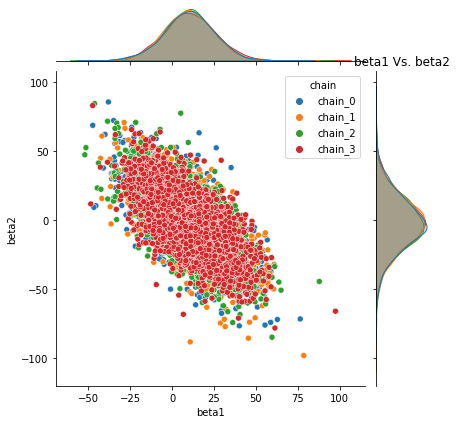


Pyro -- beta1 Vs. sigma


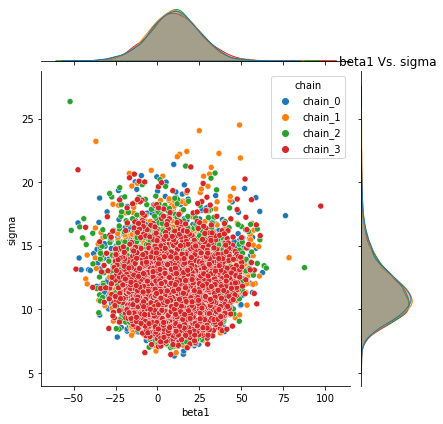


Pyro -- beta1 Vs. beta0


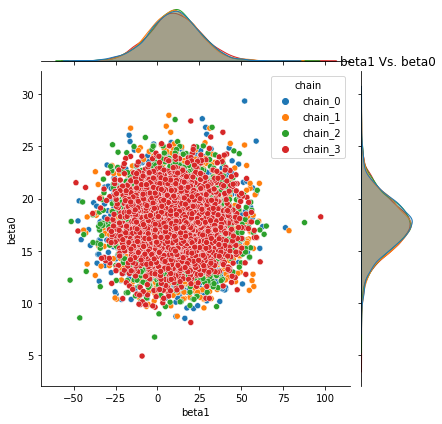


Pyro -- beta1 Vs. beta3


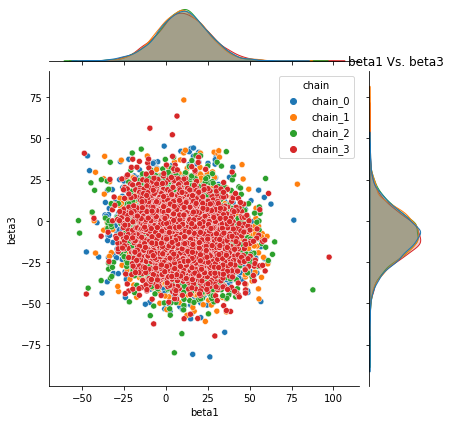


Pyro -- beta2 Vs. sigma


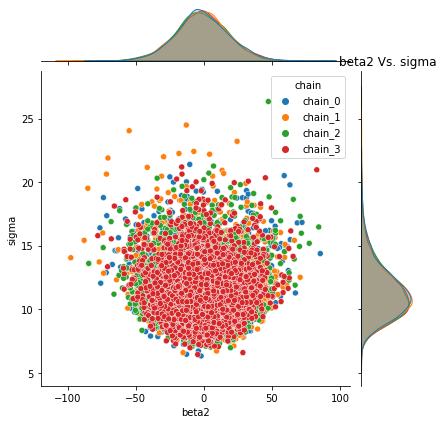


Pyro -- beta2 Vs. beta0


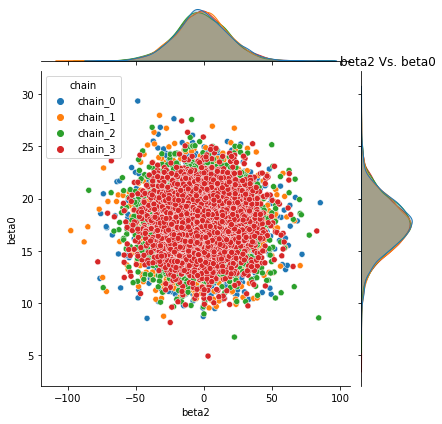


Pyro -- beta2 Vs. beta3


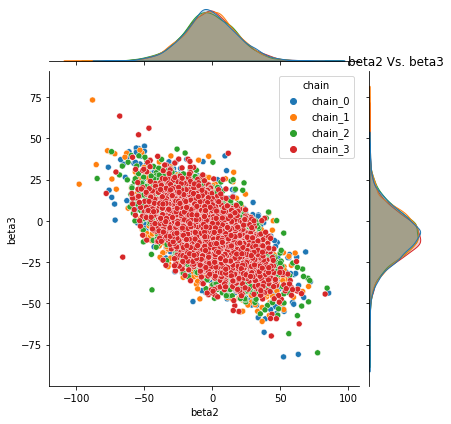


Pyro -- sigma Vs. beta0


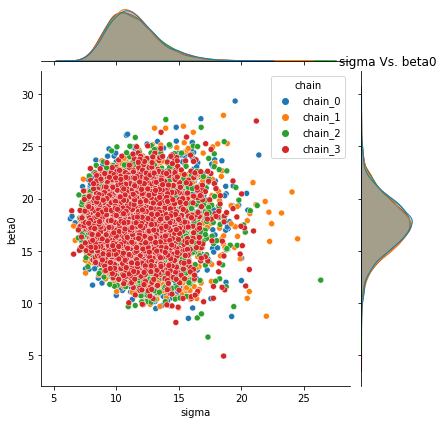


Pyro -- sigma Vs. beta3


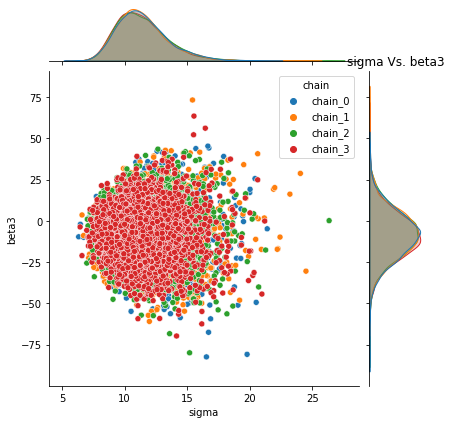


Pyro -- beta0 Vs. beta3


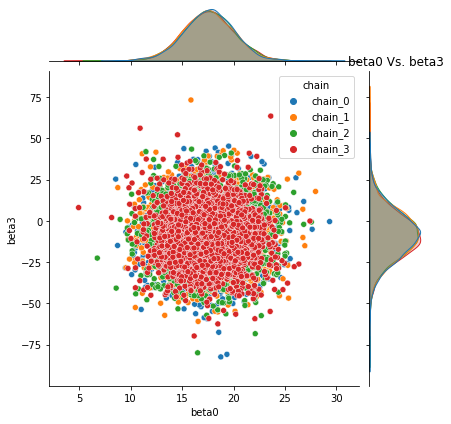

In [19]:

base.plot_joint_distribution(fit_df_A, parameters)


###### A.4.3 Pairplots
Following plots the `Pairplot distribution` of each parameter with every other parameter's sampled values for all chains of model parameters.

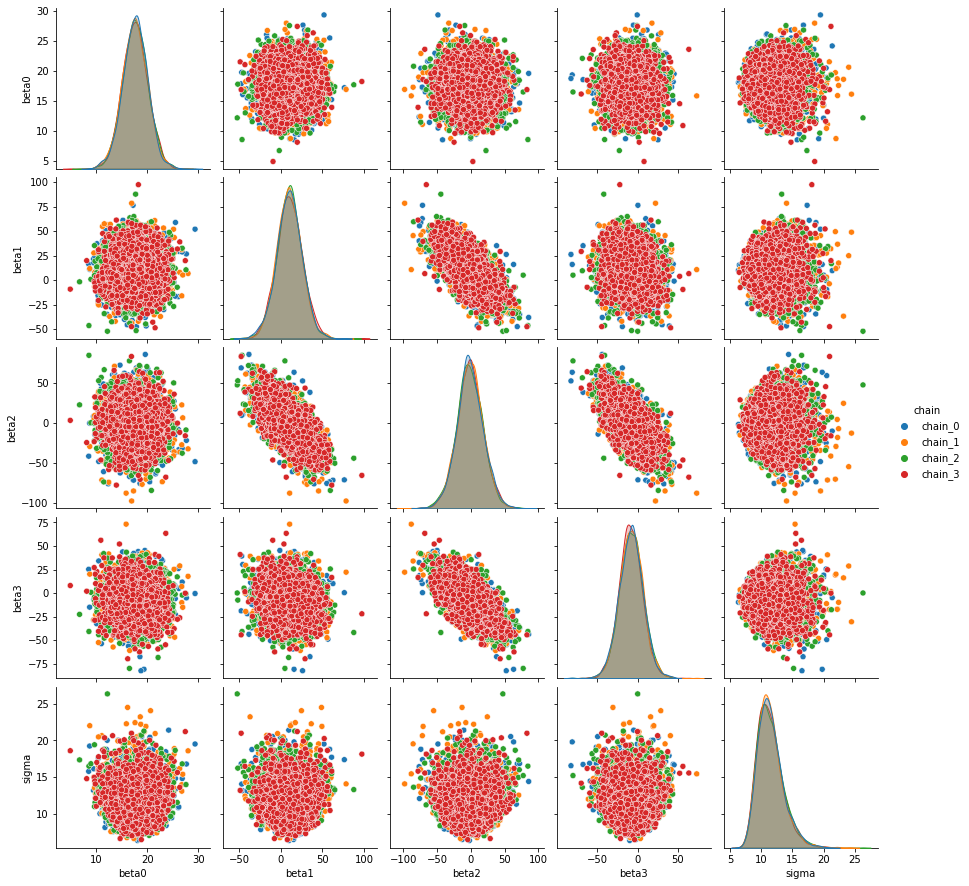

In [20]:
sns.pairplot(data=fit_df_A, hue= "chain");

#### KDE plots
Kernel density plots for models

In [21]:
import plotly.figure_factory as ff
for chain in hmc_sample_chains_a.keys():
    print("____\nFor model %s"%chain)
    chain_list= list(hmc_sample_chains_a[chain].values())
    title= "parameter distribution for : %s"%(chain)
    fig = ff.create_distplot(chain_list, list(hmc_sample_chains_a[chain].keys()))
    fig.update_layout(title=title, xaxis_title="parameter values", yaxis_title="density", legend_title="parameters")
    fig.show()
    break

____
For model chain_0


### 6. Sensitivity Analysis

Posterior Predictive Checking (PoPC) helps examine the fit of a model to real data. The simulation parameters come from the posterior distribution. While `PoPC` incorporates model uncertainly (by averaring over all possible models), we take a simpler route to begin with, which is to sample all parameters' pairs that are very plausible in the posterior (eg. the posterior means), and simulate data under this particular generative model.

In [22]:
# With priors & posteriros
posterior_parameters_pairs_a = pruned_hmc_sample_chains_a.get('chain_0')


original_plus_simulated_data_posterior, original_plus_simulated_data_posterior_df = base.simulate_observations_given_prior_posterior_pairs(Y, 
                                                                                                                        prior_simulations=original_plus_simulated_data_prior, 
                                                                                                                        model_normal_a= posterior_parameters_pairs_a)



___________

For model 'model_normal_a' posterior
total samples count: 3333  sample example:  [(11.92373, 2.4647055, 7.221754, -6.243557, 149.66736), (16.00616, 17.342953, -14.835366, -2.7280164, 67.72859)]
Total execution time: 0.07392716407775879


_______________________________________________________
______________________________________________________________________
'posterior_day_X' corresponds to observations simulated from posterior of the given model, 'prior_day_X' corresponds to observations simulated from prior of the given model, 'day_X *' corresponds to the original observations for N-th day.


In [23]:

base.save_parameter_chain_dataframe(original_plus_simulated_data_posterior_df, 
                                    "data/stacks_original_plus_simulated_data_pyro_model.csv")


Button(button_style='info', description='Save', icon='save', style=ButtonStyle(), tooltip='save')

Saved at 'data/dogs_original_plus_simulated_data_pyro_model.csv'


### 8. Inference & Analysis

Alright, we have a model, but so what? The purpose of model building is to use these models as probing devices. That is, using the models can we answer some questions about the reality that these models have abstracted. 

Plot density & contours for both parameters from `chain_0` to visualise the joint distribution & region of interest.

In [24]:
# Optionally pass select list of parameters = ['beta0', 'beta2', 'sigma']
base.plot_interaction_contours(fit_df_A, plot_3d=True)



For parameters: '['beta1', 'beta2', 'sigma']' & 'chain_0'



For parameters: '['beta1', 'beta2', 'beta0']' & 'chain_0'



For parameters: '['beta1', 'beta2', 'beta3']' & 'chain_0'



For parameters: '['beta1', 'sigma', 'beta0']' & 'chain_0'



For parameters: '['beta1', 'sigma', 'beta3']' & 'chain_0'



For parameters: '['beta1', 'beta0', 'beta3']' & 'chain_0'



For parameters: '['beta2', 'sigma', 'beta0']' & 'chain_0'



For parameters: '['beta2', 'sigma', 'beta3']' & 'chain_0'



For parameters: '['beta2', 'beta0', 'beta3']' & 'chain_0'



For parameters: '['sigma', 'beta0', 'beta3']' & 'chain_0'


### B. Pystan modelling
Pystan model for model comparison

_Note_: In case of pystan installation issues, for pyro-pystan model comparison that follows we may have to move this notebook to google colab to execute the code or reproduce the results in the section further.

In [25]:

stacks_code = """
data {
  int<lower=0> N;
  int<lower=0> p;
  real Y[N];
  matrix[N,p] x;
} 

// to standardize the x's 
transformed data {
  matrix[N,p] z;
  row_vector[p] mean_x;
  real sd_x[p];
  for (j in 1:p) { 
    mean_x[j] <- mean(col(x,j)); 
    sd_x[j] <- sd(col(x,j)); 
    for (i in 1:N)  
      z[i,j] <- (x[i,j] - mean_x[j]) / sd_x[j]; 
  }
}

parameters {
  real beta0; 
  vector[p] beta; 
  real<lower=0> sigmasq; 
} 

transformed parameters {
  real<lower=0> sigma;
  vector[N] mu;
  sigma <- sqrt(sigmasq);
  mu <- beta0 + z * beta;
}

model {
  beta0 ~ normal(0, 316); 
  beta ~ normal(0, 316); 
  sigmasq ~ inv_gamma(.001, .001);
  Y ~ normal(mu, sigma);
} 

generated quantities {
  real b0;
  vector[p] b;
  real outlier_3;
  real outlier_4;
  real outlier_21;

  for (j in 1:p)
    b[j] <- beta[j] / sd_x[j];
  b0 <- beta0 - mean_x * b;

  outlier_3  <- step(fabs((Y[3] - mu[3]) / sigma) - 2.5);
  outlier_4  <- step(fabs((Y[4] - mu[4]) / sigma) - 2.5);
  outlier_21 <- step(fabs((Y[21] - mu[21]) / sigma) - 2.5);
}
"""

stacks_data = {"p":3, "N":21, "Y":[43, 37, 37, 28, 18, 18, 19, 20, 15, 14, 14, 13, 11, 12, 8, 
7, 8, 8, 9, 15, 15], "x":np.array([80, 80, 75, 62, 62, 62, 62, 62, 59, 58, 58, 58, 58, 
58, 50, 50, 50, 50, 50, 56, 70, 27, 27, 25, 24, 22, 23, 24, 24, 
23, 18, 18, 17, 18, 19, 18, 18, 19, 19, 20, 20, 20, 89, 88, 90, 
87, 87, 87, 93, 93, 87, 80, 89, 88, 82, 93, 89, 86, 72, 79, 80, 
82, 91]).reshape((21,3))}

In [26]:
posterior = ps.StanModel(model_code=stacks_code)#, data=schools_data, random_seed=1)
fit = posterior.sampling(data=stacks_data, iter=1000, chains=4, seed=1)

In [27]:
params_pystan= fit.extract()
fit_df_pystan= fit.to_dataframe()
fit_df_pystan.head(3)

,chain,draw,warmup,beta0,beta[1],beta[2],beta[3],sigmasq,sigma,mu[1],...,outlier_3,outlier_4,outlier_21,lp__,accept_stat__,stepsize__,treedepth__,n_leapfrog__,divergent__,energy__
0,0,0,0,18.928377,3.155693,-2.190858,-4.371486,121.684728,11.031080,16.989106,...,0.0,0.0,0.0,-60.020297,0.770160,0.072835,4,27,0,62.718299
1,0,1,0,18.568419,8.092747,8.623133,-18.964355,71.151562,8.435139,20.537808,...,0.0,0.0,0.0,-60.343891,0.981741,0.072835,5,31,0,61.407529
2,0,2,0,16.428101,24.290694,-33.413709,8.423697,151.920084,12.325587,15.155982,...,0.0,0.0,0.0,-60.658132,0.985818,0.072835,6,63,0,62.314234


In [28]:

base.save_parameter_chain_dataframe(fit_df_pystan, "data/stack_regression_hmc_samples[pystan].csv")


Button(button_style='info', description='Save', icon='save', style=ButtonStyle(), tooltip='save')

Saved at 'data/stack_regression_hmc_samples[pystan].csv'


In [29]:
# Use following to load data once the results from pyro sampling operation are saved offline
load_button= base.build_upload_button()


FileUpload(value={}, accept='.csv', button_style='info', description='Upload')

In [30]:
# Use following to load data once the results from pyro sampling operation are saved offline

if load_button.value:
    fit_df_pystan = base.load_parameter_chain_dataframe(load_button)#Load "data/stack_regression_hmc_samples[pystan].csv"


In [31]:
def output_similar(param1, param2):
    result = SequenceMatcher(None, param1, param2).ratio()
    if result>0.8: return param2
    
def map_columns(param1, rel_columns):
    result= list(filter(lambda param2: output_similar(param1, param2), rel_columns))
    if result: return (result[0], param1)

In [32]:
regsample = re.compile(r'sigma$|beta[ ]?|chain')
relevant_pystan_columns = list(filter(regsample.search, list(fit_df_pystan.columns)))

pyro_pystan_cols_dict = dict(list(map(lambda pyro_param: map_columns(pyro_param, relevant_pystan_columns), parameters)))
print("Relevant pystan columns: ", relevant_pystan_columns, "\n\nPyro to pystan colummn map: ",pyro_pystan_cols_dict)

Relevant pystan columns:  ['chain', 'beta0', 'beta[1]', 'beta[2]', 'beta[3]', 'sigma'] 

Pyro to pystan colummn map:  {'beta[1]': 'beta1', 'beta[2]': 'beta2', 'sigma': 'sigma', 'beta0': 'beta0', 'beta[3]': 'beta3'}


In [33]:
fit_df_B = fit_df_pystan[relevant_pystan_columns].copy()
fit_df_B["chain"] = fit_df_B["chain"].apply(lambda x:"chain_%s"%x)
fit_df_B.rename(columns=pyro_pystan_cols_dict, inplace=True)

base.save_parameter_chain_dataframe(fit_df_B, "data/stack_regression_hmc_samples[pystan_formatted].csv")


Button(button_style='info', description='Save', icon='save', style=ButtonStyle(), tooltip='save')

Saved at 'data/stack_regression_hmc_samples[pystan_formatted].csv'


###### B Summary Table
5-point Summary Statistics for Pystan model chains.

Following outputs the similar summary of required statistics such as `"mean", "std", "Q(0.25)", "Q(0.50)", "Q(0.75)"`, but in a slightly different format, given a list of statistic names

In [34]:
# Pass any or All of the metric values as list, to view posterior summary
key_metrics= ["mean", "std", "25%", "50%", "75%"]

base.summary_stats_df_2(fit_df_B, key_metrics)

mean        std        25%        50%        75%
parameter chain                                                         
beta1     chain_0  11.037135  15.267408   0.170137  10.841768  21.652315
          chain_1  10.890145  14.611592   0.691986  11.551165  20.636765
          chain_2   9.469683  14.631706   0.285248   8.651789  17.795402
          chain_3  11.104806  14.595227   0.955593  10.605308  20.736721
beta2     chain_0  -3.471325  19.784070 -15.716704  -3.257380  10.650848
          chain_1  -2.064484  20.066303 -15.201950  -2.438730  10.997859
          chain_2  -1.024488  19.811979 -12.139112  -2.267048  11.431169
          chain_3  -1.479858  18.279741 -13.180875  -2.478856  11.111396
sigma     chain_0  11.400578   2.150765   9.867497  11.033386  12.482435
          chain_1  11.485451   2.065889   9.887893  11.245564  12.760556
          chain_2  11.423169   2.008234   9.868084  11.108659  12.583079
          chain_3  11.260700   2.128857   9.787770  10.900446  12.218846
beta0     chain_0  17.571099   2.605869  15.816209  17.543887  19.329250
          chain_1  17.575962   2.575488  16.022127  17.697151  19.206536
          chain_2  17.438131   2.585339  15.834982  17.447945  19.201057
          chain_3  17.488556   2.265300  16.055608  17.486719  18.901170
beta3     chain_0  -7.408327  15.426092 -17.112597  -7.785987   2.352674
          chain_1  -8.596175  15.746260 -18.154305  -9.713069   1.001033
          chain_2  -8.375658  13.977804 -17.215732  -8.970723   1.377498
          chain_3  -9.579874  13.260106 -17.613307  -9.552650  -0.770513

##### B Additional plots

###### B.1 Boxplots
Boxplot for Pystanmodel chains

In [35]:
# Use plot_interactive=True for plotly plots offline & False for normal matplotlib plots

base.plot_parameters_for_n_chains(fit_df_B, chains=['chain_0', 'chain_1', 'chain_2', 'chain_3'], parameters=parameters, plot_interactive=True)


###### B.2 Joint distribution plots
Following plots the `joint distribution` of `pair of each parameter` sampled values for all chains with Pystan model.


Pyro -- beta1 Vs. beta2


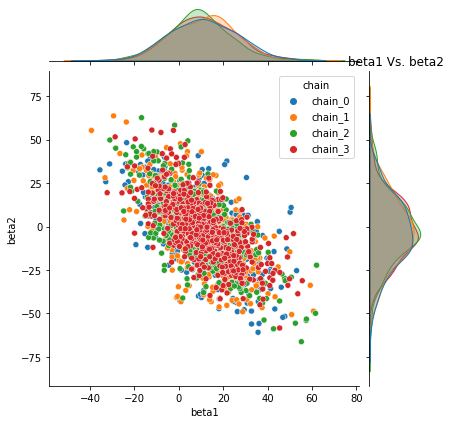


Pyro -- beta1 Vs. sigma


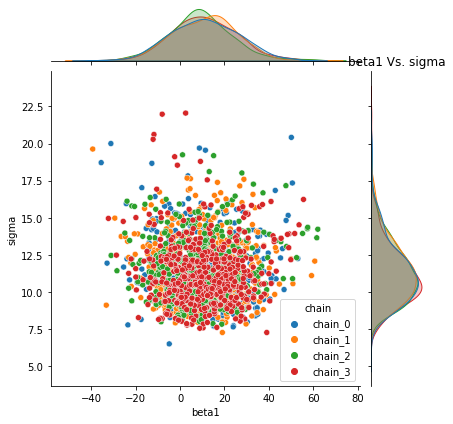


Pyro -- beta1 Vs. beta0


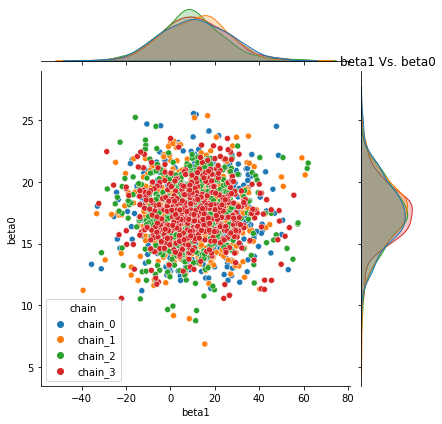


Pyro -- beta1 Vs. beta3


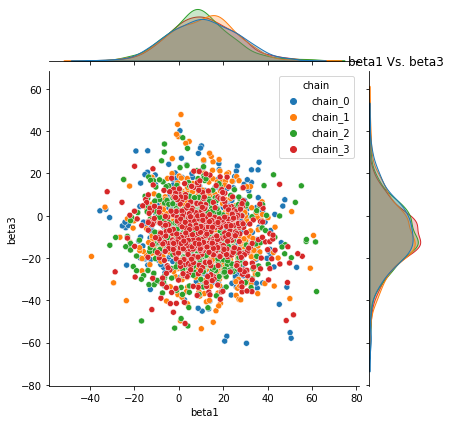


Pyro -- beta2 Vs. sigma


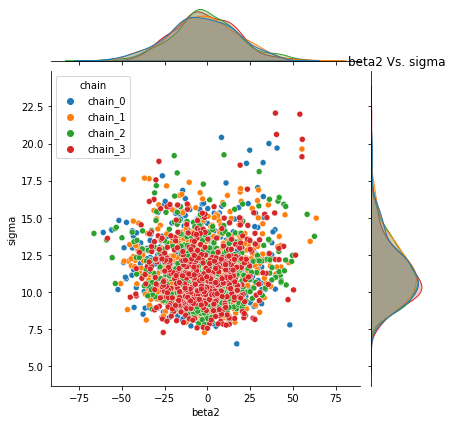


Pyro -- beta2 Vs. beta0


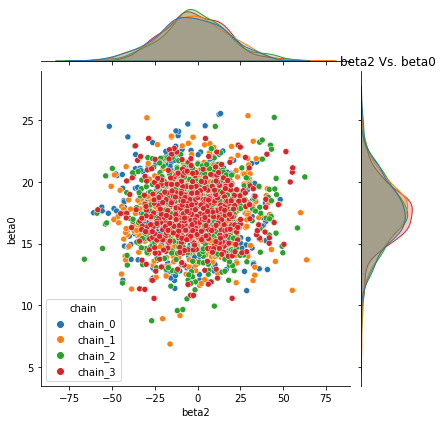


Pyro -- beta2 Vs. beta3


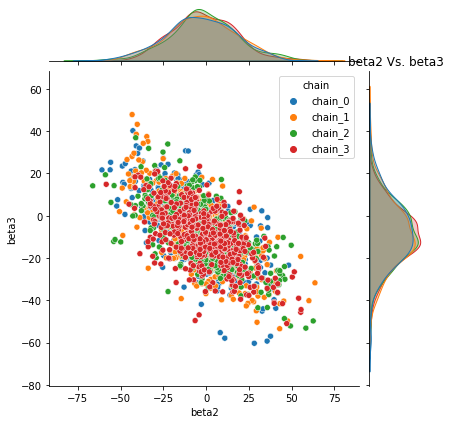


Pyro -- sigma Vs. beta0


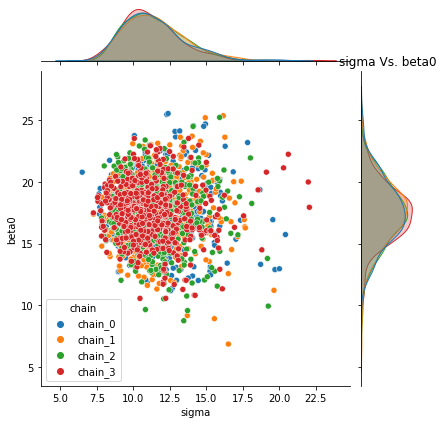


Pyro -- sigma Vs. beta3


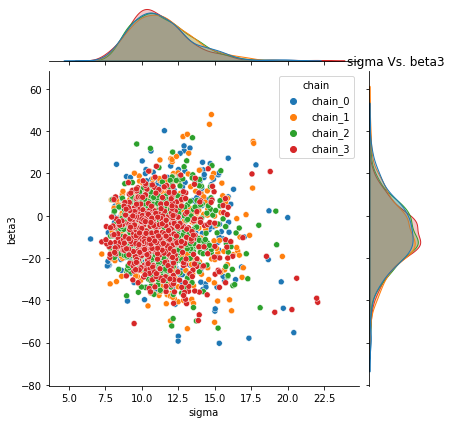


Pyro -- beta0 Vs. beta3


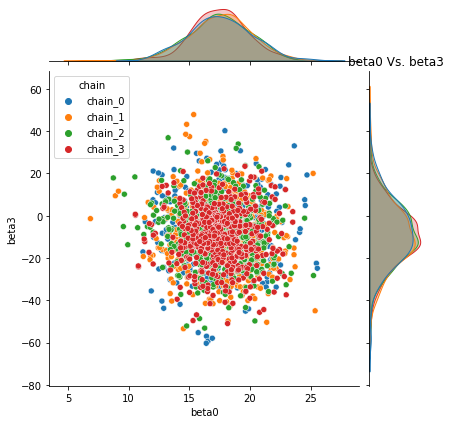

In [36]:
# plot_joint_distribution(fit_df_B, parameters)
base.plot_joint_distribution(fit_df_B, parameters)


###### B.3 Pairplots
Following plots the `Pairplot distribution` of each parameter with every other parameter's sampled values for all chains with Pystan model.

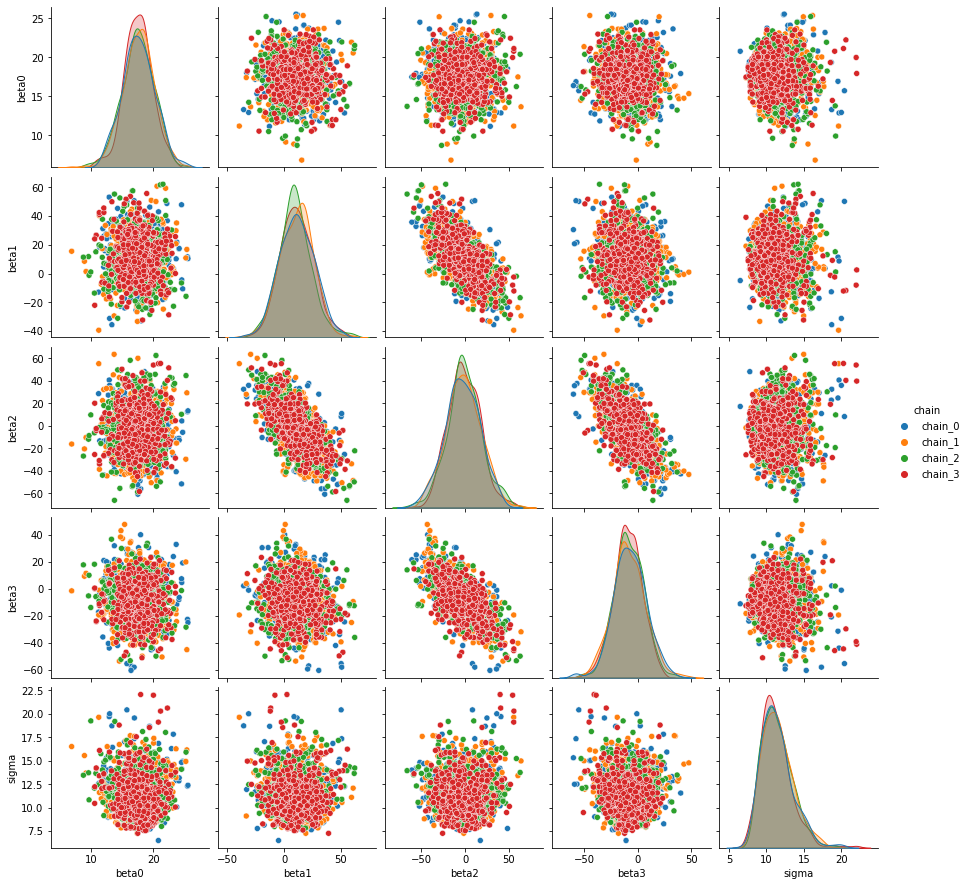

In [37]:
sns.pairplot(data=fit_df_B, hue= "chain");

### 7. Model Comparison
#### Chain intermixing plots
Plotting Intermixing of Chains from `Pyro` & `Pystan`


For pyro_parameter: beta1 & pystan_parameter: beta1


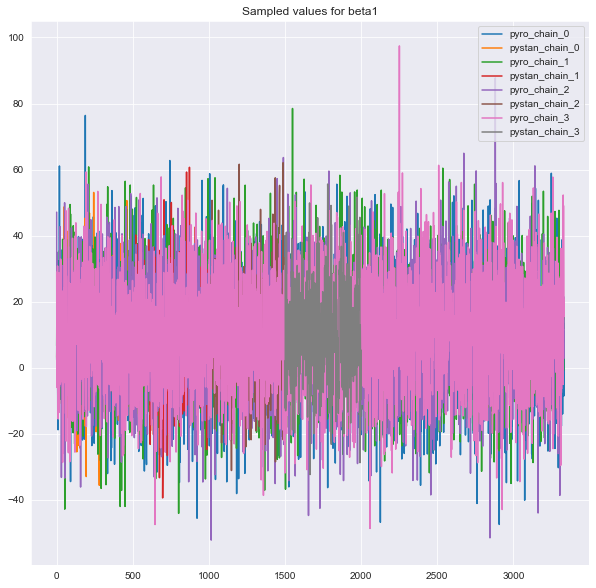


For pyro_parameter: beta2 & pystan_parameter: beta2


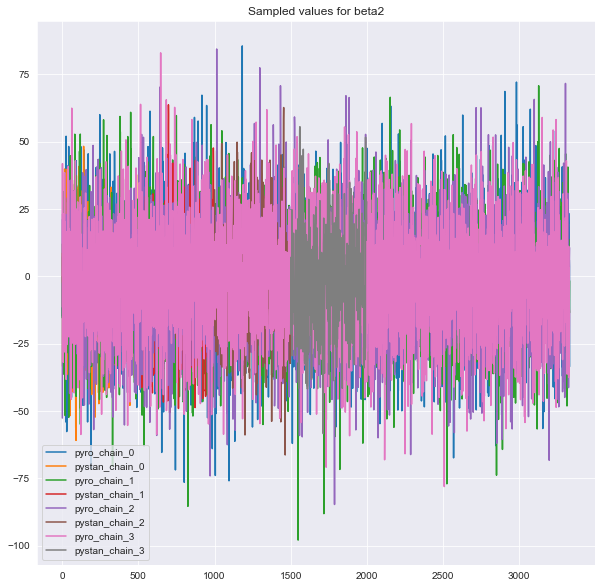


For pyro_parameter: sigma & pystan_parameter: sigma


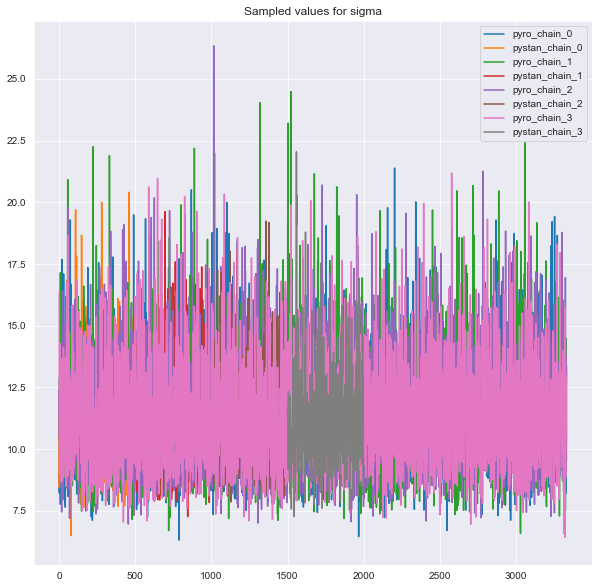


For pyro_parameter: beta0 & pystan_parameter: beta0


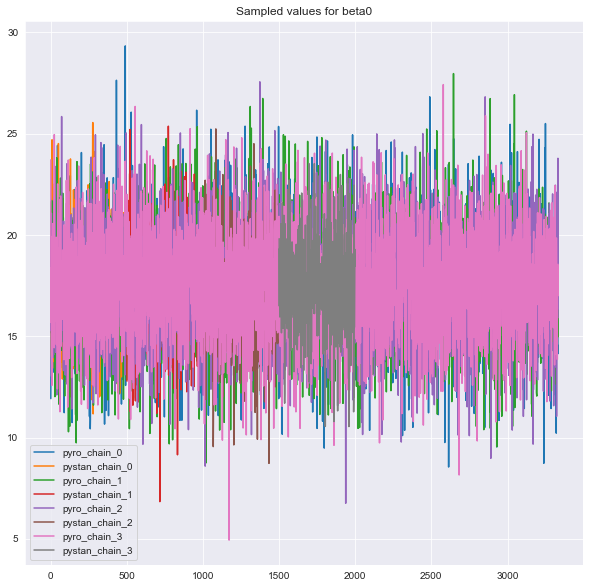


For pyro_parameter: beta3 & pystan_parameter: beta3


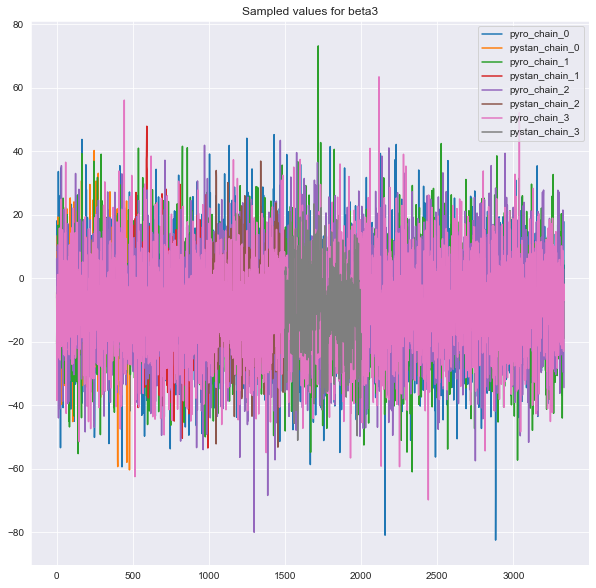

In [38]:

pyro_pystan_intermixing_chains_df = base.pyro_pystan_chain_intermixing(fit_df_A, fit_df_B)


#### Pairplot comparison between pyro & pystan samples
Pairplot distribution of each parameter with every other parameter's sampled values
* Note: resulting density plots are from chains from both pyro & pystan sampling

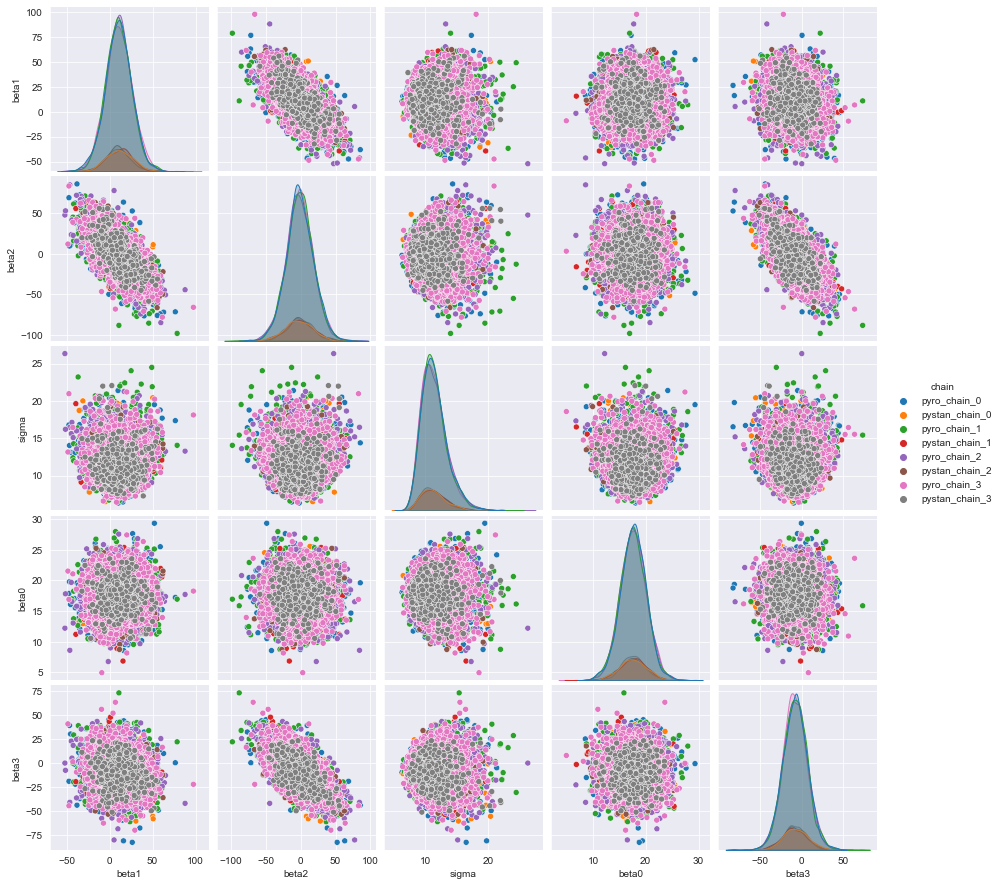

In [39]:
sns.pairplot(data=pyro_pystan_intermixing_chains_df, hue="chain");

Pass parameter names `beta0, beta1, beta2, beta3, sigma` individually along with their sample dataframes to visualise the histogram comparison of spread 

In [40]:

base.pyro_pystan_param_histograms(parameter="beta1", pyro=fit_df_A, pystan= fit_df_B)


_______________